### Geospatial Analysis

In [4]:
import pandas as pd
import seaborn as sb 
import matplotlib.pyplot as plt
import numpy as np

In [5]:
data =pd.read_csv('zomato.csv')

In [6]:
# data.head()


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

#### I need Latitudes & longitudes for each of the place for geaographical Data analysis,so to fetch lat,lon of each place,use Geopy

In [8]:
data.shape

(51717, 17)

In [9]:
len(data['location'].unique())

94

In [10]:
locations =pd.DataFrame({'Name' : data['location'].unique()})

In [11]:
locations.head()

,Name
0,Banashankari
1,Basavanagudi
2,Mysore Road
3,Jayanagar
4,Kumaraswamy Layout


In [12]:
locations['new_name']='Bengaluru ' + locations['Name'] 

In [13]:
locations

,Name,new_name
0,Banashankari,Bengaluru Banashankari
1,Basavanagudi,Bengaluru Basavanagudi
2,Mysore Road,Bengaluru Mysore Road
3,Jayanagar,Bengaluru Jayanagar
4,Kumaraswamy Layout,Bengaluru Kumaraswamy Layout
...,...,...
89,West Bangalore,Bengaluru West Bangalore
90,Magadi Road,Bengaluru Magadi Road
91,Yelahanka,Bengaluru Yelahanka
92,Sahakara Nagar,Bengaluru Sahakara Nagar


In [14]:
#!pip install geopy

In [15]:
lat_lon = []
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent= 'app')
for loc in locations['new_name']:
    location = geolocator.geocode(loc)
    if location == None:
        lat_lon.append(np.nan)
    else:
        geo = (location.latitude,location.longitude) 
        lat_lon.append(geo)

In [16]:
locations['geo_loc']=lat_lon

In [17]:
locations.head()

,Name,new_name,geo_loc
0,Banashankari,Bengaluru Banashankari,"(12.9152186, 77.5736205)"
1,Basavanagudi,Bengaluru Basavanagudi,"(12.9417261, 77.5755021)"
2,Mysore Road,Bengaluru Mysore Road,"(12.9461327, 77.5298265)"
3,Jayanagar,Bengaluru Jayanagar,"(12.9292731, 77.5824229)"
4,Kumaraswamy Layout,Bengaluru Kumaraswamy Layout,"(12.9081487, 77.5553179)"


In [18]:
Rest_location= pd.DataFrame(data['location'].value_counts().reset_index())

In [19]:
Rest_location

,index,location
0,BTM,5124
1,HSR,2523
2,Koramangala 5th Block,2504
3,JP Nagar,2235
4,Whitefield,2144
...,...,...
88,Yelahanka,6
89,West Bangalore,6
90,Jakkur,3
91,Rajarajeshwari Nagar,2


In [20]:
Rest_location.columns = ['Name','count']

#### now combine both the dataframes

In [21]:
Resturant_location = Rest_location.merge(locations,how='left',on='Name')

In [22]:
Resturant_location.head()

,Name,count,new_name,geo_loc
0,BTM,5124,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)"
1,HSR,2523,Bengaluru HSR,"(12.9116225, 77.6388622)"
2,Koramangala 5th Block,2504,Bengaluru Koramangala 5th Block,"(13.0399958, 77.6269966)"
3,JP Nagar,2235,Bengaluru JP Nagar,"(12.91226375, 77.59045672324466)"
4,Whitefield,2144,Bengaluru Whitefield,"(12.9696365, 77.7497448)"


#### Untangling the geo_loc tupple 

In [23]:
#!pip install folium

In [24]:
def generatebasemap(default_location = [13,77.6] ,default_zoom_start = 12 ):
    basemap  = folium.Map(location = default_location,zoom_start = default_zoom_start )
    return basemap

In [25]:
Resturant_location.isna().sum()

Name        0
count       0
new_name    0
geo_loc     1
dtype: int64

In [26]:
Resturant_location.dropna(axis = 0,subset =['geo_loc'], inplace = True)

In [27]:
Resturant_location.isna().sum()

Name        0
count       0
new_name    0
geo_loc     0
dtype: int64

In [28]:
Resturant_location['geo_loc'][0][0]

12.911275849999999

In [29]:
Resturant_location['geo_loc'][0][1]

77.60456543431182

In [30]:
Resturant_location['geo_loc']

0     (12.911275849999999, 77.60456543431182)
1                    (12.9116225, 77.6388622)
2                    (13.0399958, 77.6269966)
3            (12.91226375, 77.59045672324466)
4                    (12.9696365, 77.7497448)
                       ...                   
88                   (13.1006982, 77.5963454)
89                   (12.9791198, 77.5912997)
90                   (13.0784743, 77.6068938)
91                   (12.9274413, 77.5155224)
92                   (13.0329419, 77.5273253)
Name: geo_loc, Length: 92, dtype: object

In [31]:
np.array(Resturant_location['geo_loc'])

array([(12.911275849999999, 77.60456543431182), (12.9116225, 77.6388622),
       (13.0399958, 77.6269966), (12.91226375, 77.59045672324466),
       (12.9696365, 77.7497448), (12.9732913, 77.6404672),
       (12.9292731, 77.5824229), (12.9552572, 77.6984163),
       (12.887979, 77.5970812), (12.93577245, 77.66676103753434),
       (12.9791198, 77.5912997), (12.9791198, 77.5912997),
       (12.9750605, 77.6080323), (12.9340114, 77.6222304),
       (12.9340114, 77.6222304), (12.9242381, 77.6289059),
       (12.9778793, 77.6246697), (12.93433385, 77.63040639553275),
       (12.9741854, 77.6124135), (12.9152186, 77.5736205),
       (13.0221416, 77.6403368), (12.965195, 77.5996578),
       (12.996845, 77.6130165), (13.0027353, 77.5703253),
       (12.9417261, 77.5755021), (13.0527175, 77.6204272),
       (13.0141618, 77.6518539), (12.9668213, 77.7168891),
       (13.0346384, 77.5681733), (13.0093455, 77.6377094),
       (12.9882338, 77.554883), (12.9750521, 77.6046959),
       (12.9750062, 7

In [32]:
lat,lon = zip(*np.array(Resturant_location['geo_loc']))


In [33]:
Resturant_location['latitude'] = lat
Resturant_location['longitude'] = lon

In [34]:
Resturant_location.head()

,Name,count,new_name,geo_loc,latitude,longitude
0,BTM,5124,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)",12.911276,77.604565
1,HSR,2523,Bengaluru HSR,"(12.9116225, 77.6388622)",12.911623,77.638862
2,Koramangala 5th Block,2504,Bengaluru Koramangala 5th Block,"(13.0399958, 77.6269966)",13.039996,77.626997
3,JP Nagar,2235,Bengaluru JP Nagar,"(12.91226375, 77.59045672324466)",12.912264,77.590457
4,Whitefield,2144,Bengaluru Whitefield,"(12.9696365, 77.7497448)",12.969637,77.749745


In [35]:
import folium
from folium.plugins import HeatMap
basemap = generatebasemap()

In [36]:
basemap

In [37]:
Resturant_location.head()

,Name,count,new_name,geo_loc,latitude,longitude
0,BTM,5124,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)",12.911276,77.604565
1,HSR,2523,Bengaluru HSR,"(12.9116225, 77.6388622)",12.911623,77.638862
2,Koramangala 5th Block,2504,Bengaluru Koramangala 5th Block,"(13.0399958, 77.6269966)",13.039996,77.626997
3,JP Nagar,2235,Bengaluru JP Nagar,"(12.91226375, 77.59045672324466)",12.912264,77.590457
4,Whitefield,2144,Bengaluru Whitefield,"(12.9696365, 77.7497448)",12.969637,77.749745


In [38]:
Resturant_location[['latitude','longitude','count']].values.tolist()

[[12.911275849999999, 77.60456543431182, 5124.0],
 [12.9116225, 77.6388622, 2523.0],
 [13.0399958, 77.6269966, 2504.0],
 [12.91226375, 77.59045672324466, 2235.0],
 [12.9696365, 77.7497448, 2144.0],
 [12.9732913, 77.6404672, 2083.0],
 [12.9292731, 77.5824229, 1926.0],
 [12.9552572, 77.6984163, 1846.0],
 [12.887979, 77.5970812, 1630.0],
 [12.93577245, 77.66676103753434, 1286.0],
 [12.9791198, 77.5912997, 1258.0],
 [12.9791198, 77.5912997, 1238.0],
 [12.9750605, 77.6080323, 1218.0],
 [12.9340114, 77.6222304, 1181.0],
 [12.9340114, 77.6222304, 1156.0],
 [12.9242381, 77.6289059, 1065.0],
 [12.9778793, 77.6246697, 1023.0],
 [12.93433385, 77.63040639553275, 1017.0],
 [12.9741854, 77.6124135, 918.0],
 [12.9152186, 77.5736205, 906.0],
 [13.0221416, 77.6403368, 853.0],
 [12.965195, 77.5996578, 812.0],
 [12.996845, 77.6130165, 727.0],
 [13.0027353, 77.5703253, 725.0],
 [12.9417261, 77.5755021, 684.0],
 [13.0527175, 77.6204272, 675.0],
 [13.0141618, 77.6518539, 664.0],
 [12.9668213, 77.7168891, 65

#### Heatmap of North Indian restaurants

In [39]:
data.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


In [40]:
data[data['cuisines']=='North Indian'].head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
5,https://www.zomato.com/bangalore/timepass-dinn...,"37, 5-1, 4th Floor, Bosco Court, Gandhi Bazaar...",Timepass Dinner,Yes,No,3.8/5,286,+91 9980040002\r\n+91 9980063005,Basavanagudi,Casual Dining,"Onion Rings, Pasta, Kadhai Paneer, Salads, Sal...",North Indian,600,"[('Rated 3.0', 'RATED\n Food 3/5\nAmbience 3/...",[],Buffet,Banashankari
50,https://www.zomato.com/bangalore/petoo-banasha...,"276, Ground Floor, 100 Feet Outer Ring Road, B...",Petoo,No,No,3.7/5,21,+91 8026893211,Banashankari,Quick Bites,NaN,North Indian,450,"[('Rated 2.0', 'RATED\n This is a neatly made...",[],Delivery,Banashankari
72,https://www.zomato.com/bangalore/spicy-tandoor...,"Opposite ICICi Bank, Hanuman Nagar, Banashanka...",Spicy Tandoor,No,No,NEW,0,+91 8050884222,Banashankari,Quick Bites,NaN,North Indian,150,"[('Rated 4.0', 'RATED\n cost for chicken roll...",[],Delivery,Banashankari
87,https://www.zomato.com/bangalore/krishna-sagar...,"38, 22nd Main, 22nd Cross, Opposite BDA, 2nd S...",Krishna Sagar,No,No,3.5/5,31,+91 8892752997\r\n+91 7204780429,Banashankari,Quick Bites,NaN,North Indian,200,"[('Rated 1.0', 'RATED\n Worst experience with...",[],Delivery,Banashankari
94,https://www.zomato.com/bangalore/nandhini-delu...,"304, Opposite Apollo Public School, 100 Feet R...",Nandhini Deluxe,No,No,2.6/5,283,080 26890011\r\n080 26890033,Banashankari,Casual Dining,"Biryani, Chicken Guntur, Thali, Buttermilk, Ma...",North Indian,600,"[('Rated 3.0', 'RATED\n Ididnt like much.\n\n...",[],Delivery,Banashankari


In [41]:
df_north_indian = data[data['cuisines']=='North Indian'].groupby('location',as_index = False)['url'].agg('count')

In [42]:
df_north_indian.head()

,location,url
0,BTM,340
1,Banashankari,36
2,Banaswadi,12
3,Bannerghatta Road,75
4,Basavanagudi,21


In [43]:
df_north_indian.columns =['Name','count']

In [44]:
df_north_indian.head()

,Name,count
0,BTM,340
1,Banashankari,36
2,Banaswadi,12
3,Bannerghatta Road,75
4,Basavanagudi,21


In [45]:
df_north_indian = df_north_indian.merge(locations, how= 'left', on ='Name' )

In [46]:
df_north_indian.head()

,Name,count,new_name,geo_loc
0,BTM,340,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)"
1,Banashankari,36,Bengaluru Banashankari,"(12.9152186, 77.5736205)"
2,Banaswadi,12,Bengaluru Banaswadi,"(13.0141618, 77.6518539)"
3,Bannerghatta Road,75,Bengaluru Bannerghatta Road,"(12.887979, 77.5970812)"
4,Basavanagudi,21,Bengaluru Basavanagudi,"(12.9417261, 77.5755021)"


In [47]:
df_north_indian.dropna(axis = 0,subset =['geo_loc'], inplace= True)

In [48]:
df_north_indian.head()

,Name,count,new_name,geo_loc
0,BTM,340,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)"
1,Banashankari,36,Bengaluru Banashankari,"(12.9152186, 77.5736205)"
2,Banaswadi,12,Bengaluru Banaswadi,"(13.0141618, 77.6518539)"
3,Bannerghatta Road,75,Bengaluru Bannerghatta Road,"(12.887979, 77.5970812)"
4,Basavanagudi,21,Bengaluru Basavanagudi,"(12.9417261, 77.5755021)"


In [49]:
df_north_indian['latitude'],df_north_indian['longitude'] =zip(*df_north_indian['geo_loc'])

In [50]:
df_north_indian.head()

,Name,count,new_name,geo_loc,latitude,longitude
0,BTM,340,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)",12.911276,77.604565
1,Banashankari,36,Bengaluru Banashankari,"(12.9152186, 77.5736205)",12.915219,77.573621
2,Banaswadi,12,Bengaluru Banaswadi,"(13.0141618, 77.6518539)",13.014162,77.651854
3,Bannerghatta Road,75,Bengaluru Bannerghatta Road,"(12.887979, 77.5970812)",12.887979,77.597081
4,Basavanagudi,21,Bengaluru Basavanagudi,"(12.9417261, 77.5755021)",12.941726,77.575502


In [51]:
df_north_indian.drop(axis = 0,columns =['geo_loc'], inplace= True)

In [52]:
df_north_indian.head()

,Name,count,new_name,latitude,longitude
0,BTM,340,Bengaluru BTM,12.911276,77.604565
1,Banashankari,36,Bengaluru Banashankari,12.915219,77.573621
2,Banaswadi,12,Bengaluru Banaswadi,13.014162,77.651854
3,Bannerghatta Road,75,Bengaluru Bannerghatta Road,12.887979,77.597081
4,Basavanagudi,21,Bengaluru Basavanagudi,12.941726,77.575502


In [53]:
basemap = generatebasemap()
HeatMap(data = df_north_indian[['latitude', 'longitude','count']], radius = 20 ,zoom = None).add_to(basemap)
basemap


#### What about South Indian cuisines?

In [54]:
df_south_indian = data[data['cuisines']=='South Indian'].groupby('location',as_index = False)['url'].agg('count')

In [55]:
df_south_indian.head()
df_south_indian.columns =['Name','count']
df_south_indian = df_south_indian.merge(locations, how= 'left', on ='Name' )
df_south_indian.head()

,Name,count,new_name,geo_loc
0,BTM,113,Bengaluru BTM,"(12.911275849999999, 77.60456543431182)"
1,Banashankari,86,Bengaluru Banashankari,"(12.9152186, 77.5736205)"
2,Banaswadi,37,Bengaluru Banaswadi,"(13.0141618, 77.6518539)"
3,Bannerghatta Road,48,Bengaluru Bannerghatta Road,"(12.887979, 77.5970812)"
4,Basavanagudi,89,Bengaluru Basavanagudi,"(12.9417261, 77.5755021)"


In [56]:
df_south_indian.dropna(axis = 0,subset =['geo_loc'], inplace= True)
df_south_indian['latitude'],df_south_indian['longitude'] =zip(*df_south_indian['geo_loc'])
df_south_indian.drop(axis = 0,columns =['geo_loc'], inplace= True)

In [57]:
basemap_2 = generatebasemap()
HeatMap(data = df_south_indian[['latitude', 'longitude','count']], radius = 20 ,zoom = None).add_to(basemap_2)
basemap_2


#### Which are the most popular casual dining restaurant chains?

In [58]:
# Similar to pivot table
df_1 = data.groupby(['rest_type','name']).agg('count')

#sort_vaalues, groupby and apply in same line
df_new = df_1.sort_values( by ='url', axis=0, 
                          ascending= False ).groupby( by= ['rest_type'] ,as_index= False,
                          axis=0).apply(lambda x : x.sort_values(by = 'url' , 
                          ascending = False ).head(3) )['url'].reset_index().rename(columns ={'url' : 'count'})


In [59]:
df_1.head()

url  address  online_order  book_table  rate  \
rest_type name                                                                 
Bakery    7th Heaven              2        2             2           2     2   
          A Baker's Confession    4        4             4           4     0   
          A Little For Love       1        1             1           1     1   
          A1 Express              3        3             3           3     0   
          Adarsh Bakery           2        2             2           2     2   

                                votes  phone  location  dish_liked  cuisines  \
rest_type name                                                                 
Bakery    7th Heaven                2      2         2           0         2   
          A Baker's Confession      4      4         4           0         4   
          A Little For Love         1      1         1           0         1   
          A1 Express                3      3         3           0         3   
          Adarsh Bakery             2      2         2           0         2   

                                approx_cost(for two people)  reviews_list  \
rest_type name                                                              
Bakery    7th Heaven                                      2             2   
          A Baker's Confession                            4             4   
          A Little For Love                               1             1   
          A1 Express                                      3             3   
          Adarsh Bakery                                   2             2   

                                menu_item  listed_in(type)  listed_in(city)  
rest_type name                                                               
Bakery    7th Heaven                    2                2                2  
          A Baker's Confession          4                4                4  
          A Little For Love             1                1                1  
          A1 Express                    3                3                3  
          Adarsh Bakery                 2                2                2

In [60]:
df_new.head()

,level_0,rest_type,name,count
0,0,Bakery,Just Bake,49
1,0,Bakery,INDULGE by InnerChef,32
2,0,Bakery,Warm Oven,28
3,1,"Bakery, Beverage Shop",Arya S.L.Bakery,6
4,1,"Bakery, Beverage Shop",Sapna's Magic Oven,5


In [61]:
#### Wordcloud of dishes liked by cuisines.

In [62]:
from wordcloud import WordCloud,STOPWORDS

In [63]:
data['dishes_liked_updated']= data['dish_liked'].apply(lambda x : x.split(',') if type(x)== str else [''])

In [64]:
data.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city),dishes_liked_updated
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari,"[Pasta, Lunch Buffet, Masala Papad, Paneer ..."
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari,"[Momos, Lunch Buffet, Chocolate Nirvana, Th..."
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari,"[Churros, Cannelloni, Minestrone Soup, Hot ..."
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari,[Masala Dosa]
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari,"[Panipuri, Gol Gappe]"


In [65]:
data['rest_type'].value_counts()

Quick Bites                   19132
Casual Dining                 10330
Cafe                           3732
Delivery                       2604
Dessert Parlor                 2263
                              ...  
Dessert Parlor, Kiosk             2
Food Court, Beverage Shop         2
Cafe, Food Court                  2
Sweet Shop, Dessert Parlor        1
Quick Bites, Kiosk                1
Name: rest_type, Length: 93, dtype: int64

In [66]:
data['rest_type'].value_counts()[0:9]

Quick Bites           19132
Casual Dining         10330
Cafe                   3732
Delivery               2604
Dessert Parlor         2263
Takeaway, Delivery     2037
Casual Dining, Bar     1154
Bakery                 1141
Beverage Shop           867
Name: rest_type, dtype: int64

In [67]:
data['rest_type'].value_counts()[0:9].index

Index(['Quick Bites', 'Casual Dining', 'Cafe', 'Delivery', 'Dessert Parlor',
       'Takeaway, Delivery', 'Casual Dining, Bar', 'Bakery', 'Beverage Shop'],
      dtype='object')

In [68]:
data.isna().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dishes_liked_updated               0
dtype: int64

In [69]:
data.dropna(axis = 0 , subset= ['rest_type','dish_liked'],inplace = True) 

In [70]:
data.isna().sum()

url                              0
address                          0
name                             0
online_order                     0
book_table                       0
rate                            30
votes                            0
phone                          337
location                         0
rest_type                        0
dish_liked                       0
cuisines                         0
approx_cost(for two people)    134
reviews_list                     0
menu_item                        0
listed_in(type)                  0
listed_in(city)                  0
dishes_liked_updated             0
dtype: int64

### Word cloud for resturant 1 


In [71]:
dataset = data[data['rest_type'] == 'Quick Bites' ]

In [72]:
dataset['dish_liked']

3                                              Masala Dosa
31       Burgers, Lassi, Chicken Grill, Naan, Momos, Ch...
34       Rolls, Veggie Wrap, Chocolate Fantasy, Rice Bo...
40       Dabeli, Faluda, Masala Poori, Sandwiches, Tokr...
42                           Burgers, Fries, Hot Chocolate
                               ...                        
51598                          Potato Fries, Chicken Curry
51601    Rolls, Chicken Tikka Roll, Chicken Bhuna Roll,...
51617                               Coffee, Vada, Mla Dosa
51629                             Fish, Veg Thali, Biryani
51645                                              Burgers
Name: dish_liked, Length: 5289, dtype: object

In [73]:
stopwords = set(STOPWORDS)

(-0.5, 1499.5, 1499.5, -0.5)

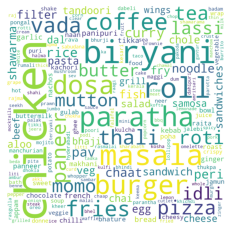

In [74]:
dishes = ''
for items in dataset['dish_liked']:
        words = items.split(',')
        for i in range(len(words)):
            words[i] = words[i].lower()
        dishes = dishes + " ".join(words) + " "
wordcloud  = WordCloud( font_path= None, stopwords=stopwords,
                       background_color='white',width=1500,height=1500, collocations=False).generate(dishes)
plt.imshow(wordcloud)
plt.axis('off')

#### analysing Reviews of Particular Restaurant

In [84]:
data1 = data['reviews_list'][0]
data1 = data1.lower()

In [85]:
import re
data2 = re.sub('[^a-zA-Z]',' ',data1)



In [86]:
data2 = re.sub('x',' ',data2)

In [87]:
data2 = re.sub('rated',' ',data2)

In [88]:
data2 = re.sub(' +',' ',data2)

In [89]:
data2

' n a beautiful place to dine in the interiors take you back to the mughal era the lightings are just perfect we went there on the occasion of christmas and so they had only limited items available but the taste and service was not compromised at all the only complaint is that the breads could have been better would surely like to come here again n i was here for dinner with my family on a weekday the restaurant was completely empty ambience is good with some good old hindi music seating arrangement are good too we ordered masala papad panner and baby corn starters lemon and corrionder soup butter roti olive and chilli paratha food was fresh and good service is good too good for family hangout ncheers n its a restaurant near to banashankari bda me along with few of my office friends visited to have buffet but unfortunately they only provide veg buffet on inquiring they said this place is mostly visited by vegetarians anyways we ordered ala carte items which took ages to come food was o

In [94]:
dataset = data[data['rest_type'] == 'Quick Bites']
type(dataset['reviews_list'][3])

str

In [103]:
total_review = ' '
for review in dataset['reviews_list']:
    review = review.lower()
    review = re.sub('[^a-zA-Z]',' ',review)
    review = re.sub('x',' ',review)
    review = re.sub('rated',' ',review)
    review = re.sub(' +',' ',review) 
    review = re.sub(' n ',' ',review) 
    total_review = total_review + str(review)

In [104]:
total_review

'  great food and proper karnataka style full meals been there twice and was fully satisfied will give stars if it s well managed reached the place at pm on saturday half of the items on the menu were over what was annoying was is the food was cold the taste was also very average only dosa and holige were good there were very few people in the restaurant and the service was still very slow the waiters were all standing in one corner and talking had to call them repeatedly had been here good food served and tasty good place to go with freinds and family should be first to get served well with all food one of the good hotel there for this price how can a udupi restaurant be so dirty the floor the walls the waiters are all stained in food why cant they clean it the floor even had decorative colour paper every where and lot of food now coming to the taste of the food it was pretty decent for what they chargw what upset us was the menu says they serve thambuli two variety of rice etc but th

(0.0, 1.0, 0.0, 1.0)

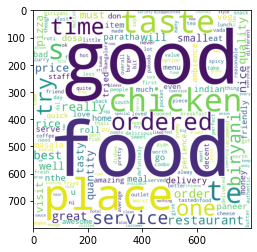

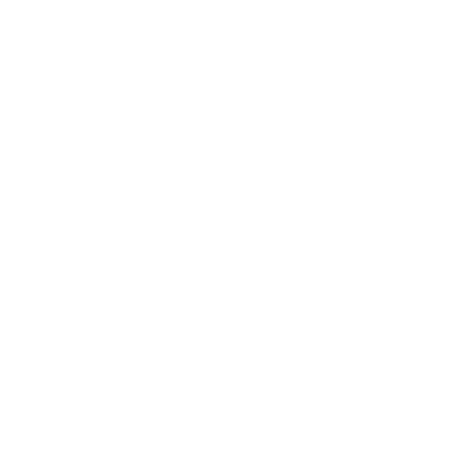

In [105]:

wordcloud  = WordCloud( font_path= None, stopwords=stopwords,
                       background_color='white',width=800,height=800, collocations=False, min_font_size= 10).generate(total_review)
plt.imshow(wordcloud)
plt.figure(figsize = (8, 8)) 
plt.axis('off')

In [111]:
def importance(resturant) :
    dataset = data[data['rest_type'] == resturant]
    type(dataset['reviews_list'][3])
    total_review = ' '
    for review in dataset['reviews_list']:
        review = review.lower()
        review = re.sub('[^a-zA-Z]',' ',review)
        review = re.sub('x',' ',review)
        review = re.sub('rated',' ',review)
        review = re.sub(' +',' ',review) 
        review = re.sub(' n ',' ',review) 
        total_review = total_review + str(review)
    wordcloud  = WordCloud( font_path= None, stopwords=stopwords,
                           background_color='white',width=1500,height=1500, collocations=False, min_font_size= 10).generate(total_review)
    plt.imshow(wordcloud)
    plt.axis('off')

KeyError: 3

In [114]:
data['rest_type']

0              Casual Dining
1              Casual Dining
2        Cafe, Casual Dining
3                Quick Bites
4              Casual Dining
                ...         
51705     Bar, Casual Dining
51707       Fine Dining, Bar
51708     Casual Dining, Bar
51711     Casual Dining, Bar
51715                    Bar
Name: rest_type, Length: 23569, dtype: object